<a href="https://colab.research.google.com/github/MavielS/segmentation-client-e-commerce/blob/master/EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Dataset disponible ici: https://www.kaggle.com/olistbr/brazilian-ecommerce

**FAIRE PRESENTATION DU NOTEBOOK + SOMMAIRE**

**Objectifs**
1. Fournir aux équipe d'e-commerce une segmentation des clients pour les campagnes de communication
2. Comprendre les différents types d'utilisateurs
3. Donner une description actionnable de cette segmentation
4. Faire une proposition de contrat de maintenance
5. Respecter norme PEP8 

- Finir l'analyse
- RFM
    - RFM brut
    - K-means
    - DBScan
    - Clustering hiérarchique
- ACP (Eliminer les variables redondantes)
    - K-means
    - DBScan
    
Evaluation avec Ajusted Rand Index / courbe silhouette<br>

_Faire des personas pour chaque cluster_



Transformation des variables en variables pertinentes <br>
    - Encoding + FE
Adaptation des hyperparamètres <br>
Nature des variables d'entrée <br>


In [1]:
%reload_ext autoreload
%autoreload 2

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import plotly.io as pio
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

from datetime import datetime
# Fichier perso
import exploration as ex

# plt.style.use('fivethirtyeight')
# plt.rcParams['figure.figsize'] = (12, 8)
# plt.rcParams['figure.dpi'] = 100

pd.set_option('plotting.backend', 'plotly')
pd.set_option("display.min_rows", 10)
pd.set_option("display.max_columns", 50)

# Découverte des jeux de données

In [56]:
prefix = './csv_files/'

customers = pd.read_csv(prefix + 'olist_customers_dataset.csv')
geolocation = pd.read_csv(prefix + 'olist_geolocation_dataset.csv', dtype={'geolocation_zip_code_prefix': str})
items = pd.read_csv(prefix + 'olist_order_items_dataset.csv')
payments = pd.read_csv(prefix + 'olist_order_payments_dataset.csv')
reviews = pd.read_csv(prefix + 'olist_order_reviews_dataset.csv')
orders = pd.read_csv(prefix + 'olist_orders_dataset.csv').astype({'order_purchase_timestamp':'datetime64','order_approved_at':'datetime64','order_delivered_carrier_date':'datetime64','order_delivered_customer_date':'datetime64','order_estimated_delivery_date':'datetime64'})
products = pd.read_csv(prefix + 'olist_products_dataset.csv')
sellers = pd.read_csv(prefix + 'olist_sellers_dataset.csv') # Non-pertinent pour l'étude

dict_csv = {'customers':customers, 'geolocation':geolocation, 'items':items, 'payments':payments,
            'reviews':reviews, 'orders':orders, 'products':products, 'sellers':sellers}

In [4]:
from tabulate import tabulate

to_disp = pd.DataFrame()

for name,df in dict_csv.items():
    
    statList = {'Nom':name, 'Nb lignes':[df.shape[0]],
                'Nb colonnes':[df.shape[1]],'Taille':[df.size],
                '% de NaN':[round(100.0 * (df.isna().sum().sum())/df.size,2)],
                'Nb duplicats':df.duplicated().sum()}
    to_disp = pd.concat([to_disp, pd.DataFrame().from_dict(statList, orient='columns')])


print(tabulate(to_disp.reset_index(drop=True), headers = 'keys', tablefmt = 'psql'))  

+----+-------------+-------------+---------------+----------+------------+----------------+
|    | Nom         |   Nb lignes |   Nb colonnes |   Taille |   % de NaN |   Nb duplicats |
|----+-------------+-------------+---------------+----------+------------+----------------|
|  0 | customers   |       99441 |             5 |   497205 |       0    |              0 |
|  1 | geolocation |     1000163 |             5 |  5000815 |       0    |         261831 |
|  2 | items       |      112650 |             7 |   788550 |       0    |              0 |
|  3 | payments    |      103886 |             5 |   519430 |       0    |              0 |
|  4 | reviews     |      100000 |             7 |   700000 |      20.93 |              0 |
|  5 | orders      |       99441 |             8 |   795528 |       0.62 |              0 |
|  6 | products    |       32951 |             9 |   296559 |       0.83 |              0 |
|  7 | sellers     |        3095 |             4 |    12380 |       0    |      

## Orders

Ce dataset va me permettre d'avoir des infos sur:
- Période avec le + d'achats
- Temps de livraison moyen
- Corrélation temps de livraison / reviews
- Fréquence d'achat d'un client sur une période

In [61]:
orders.sample(10)

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
63596,ce8394168b0c05b03e738537fbb29d2a,7cb4fbda0378687f6fa05e0aae50f1f7,delivered,2017-11-29 15:07:32,2017-12-01 11:32:12,2017-12-05 09:05:05,2017-12-22 19:08:50,2017-12-27
8047,71c8043c2b2900e423ad544aa00bbd8b,5601b281beccd2bf675238c59d20a7ad,delivered,2017-10-08 15:43:04,2017-10-08 15:56:17,2017-10-09 14:53:22,2017-10-17 18:02:27,2017-11-08
91588,95fd02c37f493e9525e3d3c1ed54653a,8bb46af2da65493427799b95d0739d34,delivered,2018-02-27 13:13:59,2018-02-27 13:28:43,2018-02-28 20:56:41,2018-03-01 12:59:14,2018-03-13
66232,148fe9089f2fc40b943388c2cb75c925,e2be316bb7b3aaf38134a136ff326375,delivered,2017-05-01 10:58:42,2017-05-01 11:05:19,2017-05-04 13:33:11,2017-05-12 13:57:00,2017-05-25
46826,4b60fd433160958739b4e6194d1c9e76,15e031cf72d00a4301c5aee54ce84bd4,delivered,2018-03-08 22:19:42,2018-03-09 00:54:48,2018-03-09 18:28:52,2018-03-26 15:06:35,2018-03-29
43519,ca3bf4af04cea159087307d0826d5ddf,afb284b37b350270338851f499c2226f,delivered,2017-07-28 00:10:57,2017-07-28 00:25:07,2017-08-04 20:05:49,2017-08-18 19:55:48,2017-08-21
96822,47e1801bc1f8eddb9969bf5fd8563712,2baba98379e3fb1bab9d4feba6b83503,delivered,2018-04-01 20:44:55,2018-04-01 20:55:39,2018-04-03 19:47:10,2018-04-07 20:16:31,2018-04-25
58089,5b57f1611ce8186213ff0f850df43fc3,cd2b0b6fa9ebbfb21e1f95f5ec70db2d,delivered,2018-03-15 17:54:17,2018-03-15 18:09:46,2018-03-16 23:49:37,2018-03-28 17:51:56,2018-04-11
60934,8fc75fa394f1ce5c0fd2775a4ae94c2c,bb678932adf8c3450d4b00d04a04dcd3,delivered,2017-09-05 09:03:02,2017-09-05 09:15:22,2017-09-12 16:44:38,2017-09-13 14:38:13,2017-09-18
56003,25ea76aff8568926deb495d6aabe42d6,78d5ad706a6e40c95e76d3b8a05d7b44,delivered,2018-04-06 13:23:07,2018-04-06 13:35:21,2018-04-11 01:42:24,2018-05-09 20:57:01,2018-05-09


Je transforme mes variables liées aux dates en type: **DateTime**

+----+----------+-------------+---------------+------------+----------------+
|    |   Taille |   Nb lignes |   Nb colonnes |   % de NaN |   Nb duplicats |
|----+----------+-------------+---------------+------------+----------------|
|  0 |   795528 |       99441 |             8 |       0.62 |              0 |
+----+----------+-------------+---------------+------------+----------------+


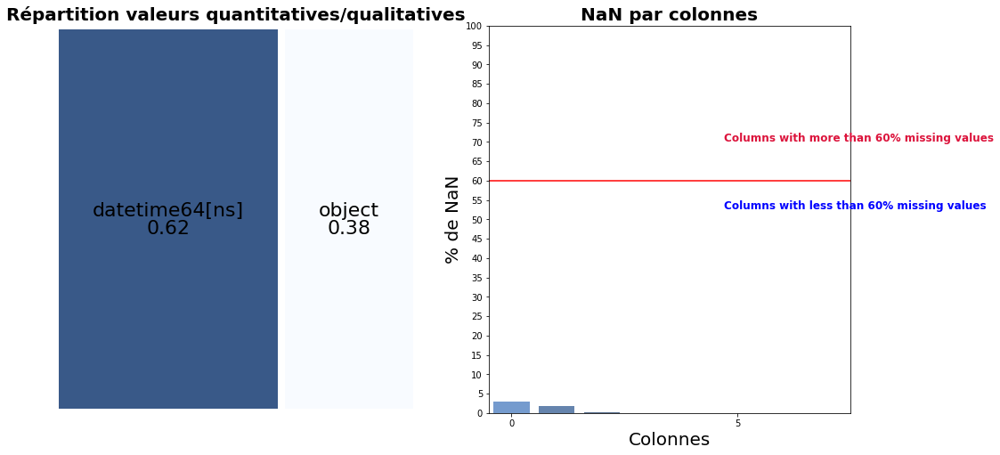

In [60]:
ex.analyse_forme(orders,all=True)

In [8]:
orders.isnull().sum()

order_id                            0
customer_id                         0
order_status                        0
order_purchase_timestamp            0
order_approved_at                 160
order_delivered_carrier_date     1783
order_delivered_customer_date    2965
order_estimated_delivery_date       0
dtype: int64

### **A quelle période trouve-t-on le plus d'achats ?**

In [9]:
print(f'Première commande: {orders.order_purchase_timestamp.min()}')
print(f'Dernière commande: {orders.order_purchase_timestamp.max()}')
print(f'Période de l\'étude: {orders.order_purchase_timestamp.max() - orders.order_purchase_timestamp.min()}')

Première commande: 2016-09-04 21:15:19
Dernière commande: 2018-10-17 17:30:18
Période de l'étude: 772 days 20:14:59


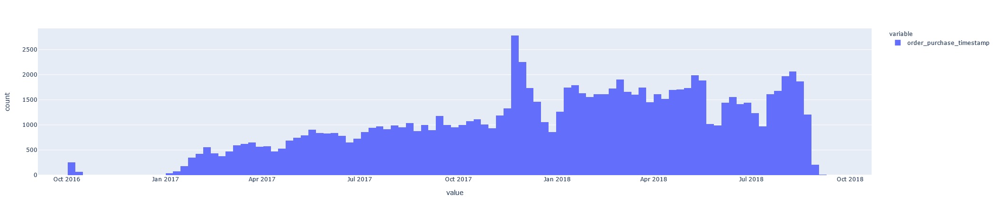

In [10]:
orders.order_purchase_timestamp.hist()

<font color='red'><b>Observations</b></font> <br>

- Il y a un pic d'achats autour de la période de Noël,
- L'année 2018 présente une hausse des ventes par rapport à 2017,
- Une période d'étude plus pertinente serait du **1er Janvier 2017 au 26 Aout 2018**, en dehors de cette période la quantité d'achat est trop instable pour être considéré comme valide. <br>


### **Temps de livraison**

In [11]:
orders['order_delivered_delay'] = (orders.order_delivered_customer_date - orders.order_approved_at).apply(func=lambda x: x.days)

Nb de bins optimal estimé: 17


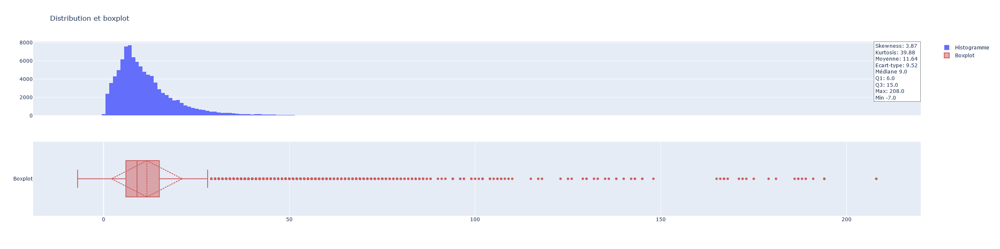

In [12]:
ex.mesure_forme_col(orders.order_delivered_delay)

<font color='red'><b>Observations</b></font> <br>

- Présence de valeurs extremes (+ de 100 jours de délai de livraison)
- Un ou plusieurs délais de livraisons négatifs 
- 75% des temps de livraison entre 6 et 15j

## Reviews

In [37]:
reviews.head(10)

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10 00:00:00,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 14:36:24
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21 00:00:00,2017-04-21 22:02:06
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,NaN,Parabéns lojas lannister adorei comprar pela I...,2018-03-01 00:00:00,2018-03-02 10:26:53
5,15197aa66ff4d0650b5434f1b46cda19,b18dcdf73be66366873cd26c5724d1dc,1,NaN,NaN,2018-04-13 00:00:00,2018-04-16 00:39:37
6,07f9bee5d1b850860defd761afa7ff16,e48aa0d2dcec3a2e87348811bcfdf22b,5,NaN,NaN,2017-07-16 00:00:00,2017-07-18 19:30:34
7,7c6400515c67679fbee952a7525281ef,c31a859e34e3adac22f376954e19b39d,5,NaN,NaN,2018-08-14 00:00:00,2018-08-14 21:36:06
8,a3f6f7f6f433de0aefbb97da197c554c,9c214ac970e84273583ab523dfafd09b,5,NaN,NaN,2017-05-17 00:00:00,2017-05-18 12:05:37
9,8670d52e15e00043ae7de4c01cc2fe06,b9bf720beb4ab3728760088589c62129,4,recomendo,aparelho eficiente. no site a marca do aparelh...,2018-05-22 00:00:00,2018-05-23 16:45:47


In [47]:
reviews.isnull().sum()/reviews.shape[0]

review_id                  0.00000
order_id                   0.00000
review_score               0.00000
review_comment_title       0.88285
review_comment_message     0.58247
review_creation_date       0.00000
review_answer_timestamp    0.00000
review_with_comment        0.00000
dtype: float64

<font color='red'><b>Observations</b></font> <br>

- Toutes les commandes ont reçu une note <br>
- 40% des commandes ont reçu un commentaire

In [34]:
reviews.order_id.duplicated().sum()

559

J'ai certains doublons d'order_id dans reviews: certaines commandes ont reçu plusieurs commentaires/notes.

In [18]:
reviews[reviews.order_id.duplicated(keep=False)].sort_values(by='order_id')

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
25802,89a02c45c340aeeb1354a24e7d4b2c1e,0035246a40f520710769010f752e7507,5,NaN,NaN,2017-08-29 00:00:00,2017-08-30 01:59:12
22585,2a74b0559eb58fc1ff842ecc999594cb,0035246a40f520710769010f752e7507,5,NaN,Estou acostumada a comprar produtos pelo barat...,2017-08-25 00:00:00,2017-08-29 21:45:57
22946,ab30810c29da5da8045216f0f62652a2,013056cfe49763c6f66bda03396c5ee3,5,NaN,NaN,2018-02-22 00:00:00,2018-02-23 12:12:30
69191,73413b847f63e02bc752b364f6d05ee9,013056cfe49763c6f66bda03396c5ee3,4,NaN,NaN,2018-03-04 00:00:00,2018-03-05 17:02:00
83893,d8e8c42271c8fb67b9dad95d98c8ff80,0176a6846bcb3b0d3aa3116a9a768597,5,NaN,NaN,2017-12-30 00:00:00,2018-01-02 10:54:47
...,...,...,...,...,...,...,...
27663,5e78482ee783451be6026e5cf0c72de1,ff763b73e473d03c321bcd5a053316e8,3,NaN,Não sei que haverá acontecido os demais chegaram,2017-11-18 00:00:00,2017-11-18 09:02:48
41665,39de8ad3a1a494fc68cc2d5382f052f4,ff850ba359507b996e8b2fbb26df8d03,5,NaN,Envio rapido... Produto 100%,2017-08-16 00:00:00,2017-08-17 11:56:55
18916,80f25f32c00540d49d57796fb6658535,ff850ba359507b996e8b2fbb26df8d03,5,NaN,"Envio rapido, produto conforme descrito no anu...",2017-08-22 00:00:00,2017-08-25 11:40:22
54388,5476dd0eaee7c4e2725cafb011aa758c,ffaabba06c9d293a3c614e0515ddbabc,3,NaN,NaN,2017-12-20 00:00:00,2017-12-21 13:24:55


Je remarque que pour ces doublons de commandes, certains ont un commentaire et d'autres n'en ont pas. <br>
TODO: Conserver celui qui a un commentaire et supprimer l'autre.

### Répartition des review_scores

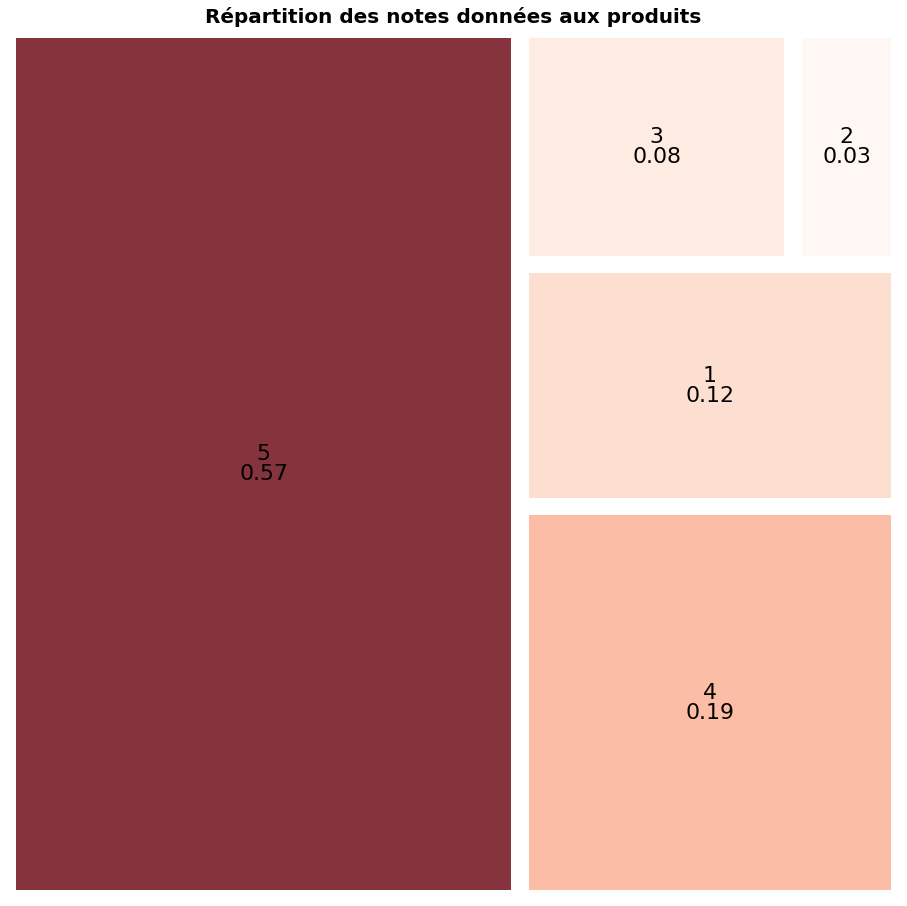

In [18]:
ex.squarify_value_counts(reviews.review_score, title='Répartition des notes données aux produits')

<font color='red'><b>Observations</b></font> <br>

- Environ 75% des commandes se sont bien voire très bien passées (4 ou 5 *) <br>

### Notes laissés avec commentaire

Dans le cadre de ce projet je ne pense pas étudier en précision les commentaires laissés, cependant il est intéréssant de noter pour chaque commande si un commentaire a été laissé.

In [22]:
reviews['review_with_comment'] = reviews.review_comment_message.notnull().apply(func=lambda x: 1 if x else 0)

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,review_with_comment
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59,0
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10 00:00:00,2018-03-11 03:05:13,0
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 14:36:24,0
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21 00:00:00,2017-04-21 22:02:06,1
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,NaN,Parabéns lojas lannister adorei comprar pela I...,2018-03-01 00:00:00,2018-03-02 10:26:53,1
...,...,...,...,...,...,...,...,...
99995,f3897127253a9592a73be9bdfdf4ed7a,22ec9f0669f784db00fa86d035cf8602,5,NaN,NaN,2017-12-09 00:00:00,2017-12-11 20:06:42,0
99996,b3de70c89b1510c4cd3d0649fd302472,55d4004744368f5571d1f590031933e4,5,NaN,"Excelente mochila, entrega super rápida. Super...",2018-03-22 00:00:00,2018-03-23 09:10:43,1
99997,1adeb9d84d72fe4e337617733eb85149,7725825d039fc1f0ceb7635e3f7d9206,4,NaN,NaN,2018-07-01 00:00:00,2018-07-02 12:59:13,0
99998,be360f18f5df1e0541061c87021e6d93,f8bd3f2000c28c5342fedeb5e50f2e75,1,NaN,Solicitei a compra de uma capa de retrovisor c...,2017-12-15 00:00:00,2017-12-16 01:29:43,1


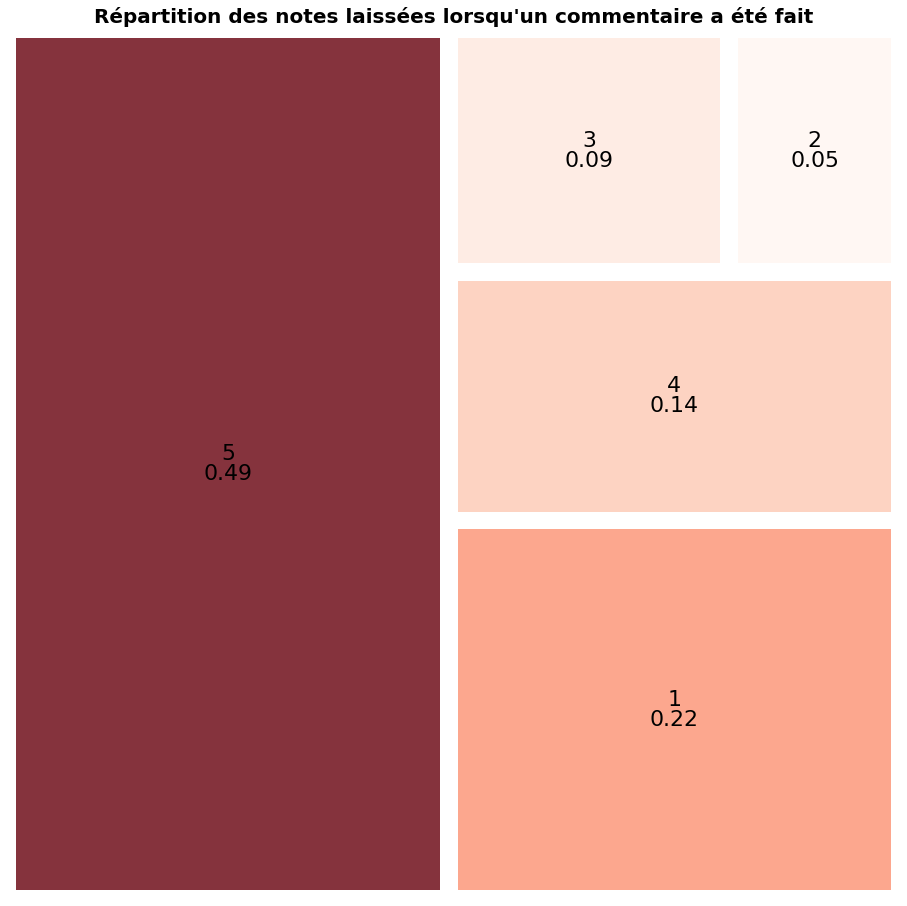

In [46]:
ex.squarify_value_counts(reviews[reviews.review_comment_message.notnull()].review_score, title='Répartition des notes laissées lorsqu\'un commentaire a été fait')

<font color='red'><b>Observations</b></font> <br>

- Les commentaires ne semblent pas être liés à la qualité d'une commande <br>

TODO: Test statistique <bR>
Hypothèse H0: La note impacte l'action de laisser un commentaire. <br>

## Payments

In [39]:
payments.sample(10)

,order_id,payment_sequential,payment_type,payment_installments,payment_value
34896,b02fd360342e2520c0361b430c150a92,1,credit_card,3,31.75
83116,a1123c93471aa08ec72dfd5c941edcdc,1,credit_card,5,218.15
34039,458fd3c506b852c0ceeb6e7c195ea437,1,credit_card,1,62.43
62230,d3137f0d4c2ad2e593c900f406f344a2,1,boleto,1,50.50
31295,9f33a39fe21aa7e49c58d5c16da393a0,1,credit_card,5,54.42
82523,0f9d568730bf125dbbfed4fc655ff91a,1,credit_card,10,284.71
45988,e33408facb2edeacee1b12d13b100fcc,1,credit_card,8,114.77
5908,b50ba114699ad96c55931d8d58b6dbda,2,voucher,1,19.09
83316,19cfcf45fc399af9d3e9d1d98638997b,1,credit_card,10,121.09
51370,10baace34a8f00b9b8a872d49d897fc9,1,credit_card,6,479.50


**payment_sequential** = Un client peut choisir de payer une commande avec plusieurs moyens de paiements <br>
**payment_installment** = Facilité de paiement : Paiement en plusieurs fois

### Quelles commandes ont reçu plusieurs paiements ?

In [40]:
payments.order_id.duplicated().sum()

4446

In [41]:
payments[payments.order_id.duplicated(keep=False)].sort_values(by='order_id')

,order_id,payment_sequential,payment_type,payment_installments,payment_value
80856,0016dfedd97fc2950e388d2971d718c7,2,voucher,1,17.92
89575,0016dfedd97fc2950e388d2971d718c7,1,credit_card,5,52.63
20036,002f19a65a2ddd70a090297872e6d64e,1,voucher,1,44.11
98894,002f19a65a2ddd70a090297872e6d64e,2,voucher,1,33.18
30155,0071ee2429bc1efdc43aa3e073a5290e,2,voucher,1,92.44
...,...,...,...,...,...
21648,ffa1dd97810de91a03abd7bd76d2fed1,2,voucher,1,418.73
32912,ffa39020fe7c8a3e907320e1bec4b985,1,credit_card,1,7.13
3009,ffa39020fe7c8a3e907320e1bec4b985,2,voucher,1,64.01
75188,ffc730a0615d28ec19f9cad02cb41442,1,credit_card,1,14.76


De même ici, j'ai certaines commandes qui ont reçu plusieurs paiements. <br>
Je ne comprends pas bien d'où cela vient, il s'agit peut être d'erreurs. <br>

### Quel est le type de paiement préféré ?

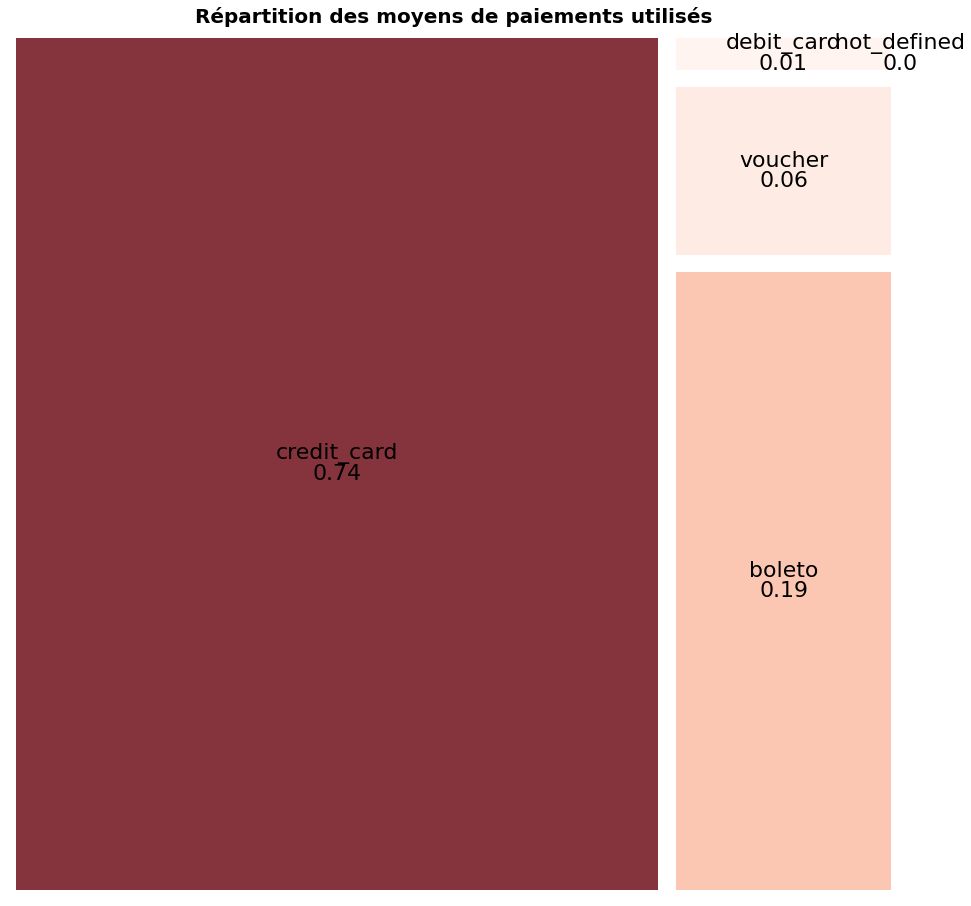

In [49]:
ex.squarify_value_counts(payments.payment_type, title='Répartition des moyens de paiements utilisés')

<font color='red'>**Observations**</font> <br>

- Environ 75% des achats sont faits par CB <br>
- Le boleto est un moyen de paiement spécifique au Brésil, 
Lorsqu’il est nécessaire de payer une facture, un abonnement, un service, etc, les institutions brésiliennes offrent la possibilité (ou l’obligation) de régler la somme dûe directement à la banque au moyen d’un « boleto », document bancaire officiel faisant office de facture.

### Comment sont répartis les paiements ?

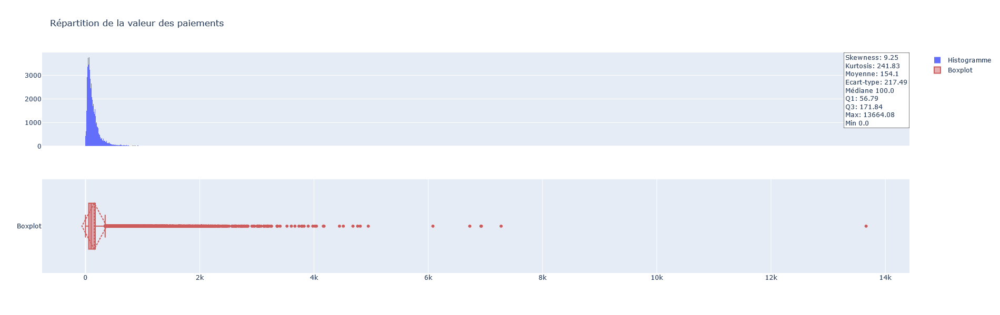

In [18]:
ex.mesure_forme_col(payments.payment_value, bins=50, title='Répartition de la valeur des paiements', figsize=(16,12))

In [16]:
np.quantile(payments.payment_value, 0.97)

609.2345

<font color='red'><b>Observations</b></font> <br>

- Un fort étalement vers la droite, un étirement fortement positif (Kurtosis proche de 240!)
- 75% des paiements sont inférieurs à ~172 reals
- 97% des paiements sont inférieurs à ~609 reals

## Customers

In [55]:
customers.sample(10)

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
91795,1701de86da9c0357f7fdbbae51e66c29,ceb66cc17afe15e697db5f8ba47c7182,20710,rio de janeiro,RJ
73454,1f4e8bd03181879e40424354c00dea4d,353027c49c4fb3c827f2745b44ebb3f2,6075,osasco,SP
27061,95539321a91156c4393281cee799ef41,037f310c86d001ce53c80b004af836e3,18087,sorocaba,SP
57728,5ce0619a7329b660555979b32001ccfd,a0727f661704ca444af6bd197021d027,34505,sabara,MG
75342,2b4c285c63cde3581cb7d06b70db65c4,e1c02550e84159111c72c83aeb1389dd,39440,janauba,MG
12391,d7d9e807fdc3e0515504b5cb83e374f2,b75c46ad64ec14c75293c683a9d26c9e,16402,lins,SP
77809,db12eed5694b676a8e2e6943eabf3353,11494ac4b94a215ddb5a75f30127071f,7792,cajamar,SP
36061,c5ee29a7bd87f451fb68f5d6ee2d8cc6,190291429a0d2886dfd20d2372779d72,30130,belo horizonte,MG
30328,352960fe6741c7944bd2007d8d1d3f64,eec8231e8d513be98954dbcbe946528d,13389,nova odessa,SP
59385,73619b350b42a898dc24b298aea7d1e6,3177fe6dc09992fd1ea77cf0e50cceeb,58035,joao pessoa,PB


customer_id : Clé pour assembler avec le dataset *orders*, chaque commande à un customer_id unique. <br>
customer_unique_id : id unique d'un client <br>

In [58]:
customers.isna().sum()/customers.shape[0]

customer_id                 0.0
customer_unique_id          0.0
customer_zip_code_prefix    0.0
customer_city               0.0
customer_state              0.0
dtype: float64

In [72]:
customers.shape

(99441, 5)

### Plusieurs commandes par les mêmes clients

In [60]:
customers.customer_unique_id.duplicated().sum()

3345

La présence de doublons ici m'indique des clients ayant fait plusieurs commandes.

In [96]:
customers.customer_unique_id.duplicated().sum()/customers.shape[0]

0.033638036624732255

---

Je créé une nouvelle colonne contenant le nombre de commandes effectuées par ce client.

In [92]:
customers['customer_total_commands'] = customers.customer_unique_id.apply(func=lambda id: customers_vc.loc[id])

In [94]:
customers.customer_total_commands.max()

17

Nb de bins optimal estimé: 8


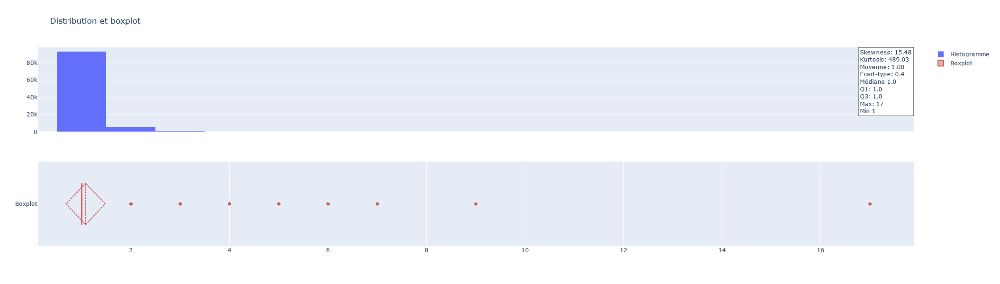

In [95]:
ex.mesure_forme_col(customers.customer_total_commands)

<font color='red'><b>Observations</b></font> <br>

- 3% des clients ont fait plus d'une commande

## Items

In [5]:
items.sample(10)

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
40389,5bf0c7788e61420541921eb52120d901,2,42a2c92a0979a949ca4ea89ec5c7b934,813348c996469b40f2e028d5429d3495,2017-11-21 13:06:55,58.9,10.62
98140,de997de62f053c73ff6c2dea94b124f7,1,138d7037b59dcee052810952c983033b,218d46b86c1881d022bce9c68a7d4b15,2018-06-25 22:18:44,169.0,23.98
90925,ce86fa5a5108884726a2244bcae51ae6,1,f5d8f4fbc70ca2a0038b9a0010ed5cb0,48efc9d94a9834137efd9ea76b065a38,2017-01-09 13:29:03,10.9,8.72
43169,622dac2e43c9fe4e17d08cbc259f8448,1,bb50f2e236e5eea0100680137654686c,f7ba60f8c3f99e7ee4042fdef03b70c4,2017-09-25 21:30:22,325.0,17.02
15879,2446d3b0814e1baa4253e67f59f9c509,1,45f0310974e6082deeda855f91984347,0241d4d5d36f10f80c644447315af0bd,2018-02-09 21:15:30,129.0,21.74
84580,c02e19b57ca332a2dd2e61ff8b2f07ca,1,a92930c327948861c015c919a0bcb4a8,6560211a19b47992c3666cc44a7e94c0,2018-06-18 02:17:18,78.0,22.48
18707,2aff111da5413ddf7c6ab3717f366c06,1,81a5ad77c14cd83d0c853e4c317cb837,e5a38146df062edaf55c38afa99e42dc,2018-04-10 14:07:59,78.0,20.60
28199,4036f899610ca6b249129cf1b59ae8f5,1,80d2404aa74015aa6cd21863642295f7,adbc26658d6c7b4b6219f9d934598091,2018-08-02 14:04:26,109.9,23.99
16880,26a95c7a47327bed47c5651221bfcb18,1,46b173c179c7e6904a5728959bee5b3a,7299e27ed73d2ad986de7f7c77d919fa,2017-09-18 19:50:24,160.0,16.88
67609,9aa01fd658d6e6794dfc650349c61735,1,9d8a0e115e802d845b4ce1eb794d1260,d05ae8f7a5bd1d2a690a44cd079e4e27,2018-03-22 17:50:33,120.0,7.87


shipping_limit_data: Affiche la date limite d'expédition du vendeur pour le traitement de la commande au partenaire logistique. <br>
freight_value: Frais de livraison, s'il y a plusieurs items, ces frais sont divisés par le nb d'items.

---

Je cherche à connaitre le prix total d'une commande ainsi que le prix total des frais de port.

In [6]:
items['order_total_price'] = items.order_id.apply(func=lambda id: items[items.order_id == str(id)].price.sum())

items['order_total_freight'] = items.order_id.apply(func=lambda id: items[items.order_id == str(id)].freight_value.sum())

In [7]:
items.sample(10)

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,order_total_price,order_total_freight
87109,c5d16e3d5c24cc5fa2200d448d8cb4d7,1,cac9e5692471a0700418aa3400b9b2b1,36890be00bbfc1cdb9a4a38a6af05a69,2018-06-29 19:19:00,98.90,18.79,98.90,18.79
18773,2b233b3b91f2164ae046d169a3d975ee,1,b35ce9c1e37f5b0f4134da0fe4c93b84,dd2bdf855a9172734fbc3744021ae9b9,2017-03-09 01:32:48,69.90,26.75,69.90,26.75
64694,93ce5dbe519fd117a153211be6475a39,1,daf8adfbc53d524b875b71e3c16b653b,1025f0e2d44d7041d6cf58b6550e0bfa,2018-04-16 07:35:23,41.89,12.43,41.89,12.43
62821,8f6f263a5e96515d5534199b74cb7748,5,c3f8ee7e05c01c61ab863e336b0f2e5e,6039e27294dc75811c0d8a39069f52c0,2018-03-16 14:50:59,219.90,47.28,1319.40,283.68
57148,82101da55cd8646eed9d29379b7b2777,1,f6e0b7ccc34e4decc1b855f8da06a5fc,2a7dc43cecabf23403078e2188437d1d,2017-12-19 09:11:15,149.90,17.30,149.90,17.30
93540,d408389e6d1324a47e2ddac6953406b1,1,9c6db8c47fae241469bec6c43c674bce,2a84855fd20af891be03bc5924d2b453,2018-02-15 11:35:31,299.90,31.51,299.90,31.51
36567,52faca764f10e3c9f0527267b3aa7c95,1,81e7937893af4703d4d14ca3e3765b59,855668e0971d4dfd7bef1b6a4133b41b,2017-12-07 04:39:05,64.99,19.64,130.98,31.42
92887,d29d63928559ca53630a4e064a42381a,1,2eb9b2ef7c1da3c7b99702452ea4729f,0db783cfcd3b73998abc6e10e59a102f,2017-04-06 06:42:28,99.00,25.18,99.00,25.18
63086,900701305cbfcd012076fb429e5affe2,1,99a4788cb24856965c36a24e339b6058,4a3ca9315b744ce9f8e9374361493884,2018-02-12 15:30:30,86.90,21.10,86.90,21.10
22235,32d56cb1bbbd589167889e0c84057efe,1,ec037c3c954465515942793fc7ce665a,c64a2aec32cc408a8a4c6d7c46017f91,2017-11-30 16:52:56,127.50,17.37,127.50,17.37


### Comment se répartissent le coût des frais de port par item ?

Nb de bins optimal estimé: 30


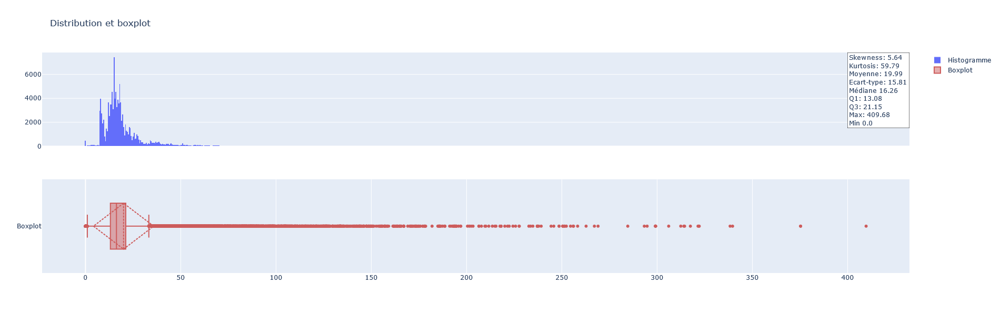

In [106]:
ex.mesure_forme_col(items.freight_value)

## Products

In [67]:
products.sample(10)

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
9049,63cbf4066cf395d6634831160ddacbbd,moveis_decoracao,53.0,356.0,1.0,1200.0,20.0,16.0,20.0
976,d2806dfb8e3474bcba8b5bcd771ff12c,brinquedos,58.0,789.0,2.0,790.0,28.0,24.0,31.0
25197,f5f0e64686adaf487590fbb8a75a1d2c,esporte_lazer,51.0,929.0,1.0,2200.0,22.0,22.0,22.0
8744,afc74793355c715ee40757a15b1cf31d,eletrodomesticos_2,50.0,379.0,1.0,11200.0,35.0,25.0,45.0
6825,4e4533c3f5832b58737e5a6229fe39f5,cama_mesa_banho,54.0,515.0,1.0,1000.0,16.0,10.0,16.0
15776,19bcd4eb05ab42b8bd0976cf94bffd7b,informatica_acessorios,38.0,951.0,1.0,225.0,16.0,5.0,13.0
9768,f60fedc54d28bf29480f654d90a2f8ff,cama_mesa_banho,41.0,614.0,1.0,950.0,30.0,16.0,16.0
31851,58b81e95d79fc90308246d12ef1e2688,malas_acessorios,59.0,561.0,7.0,1850.0,32.0,52.0,19.0
29132,36038dae78cc227e4d14b174f0f695d0,esporte_lazer,42.0,1357.0,1.0,2200.0,20.0,20.0,20.0
5701,7e1fa9dcf2c39f7fe71d43ce0a09dbb5,eletrodomesticos,57.0,416.0,1.0,11950.0,50.0,2.0,37.0


### Répartition des catégories de produits

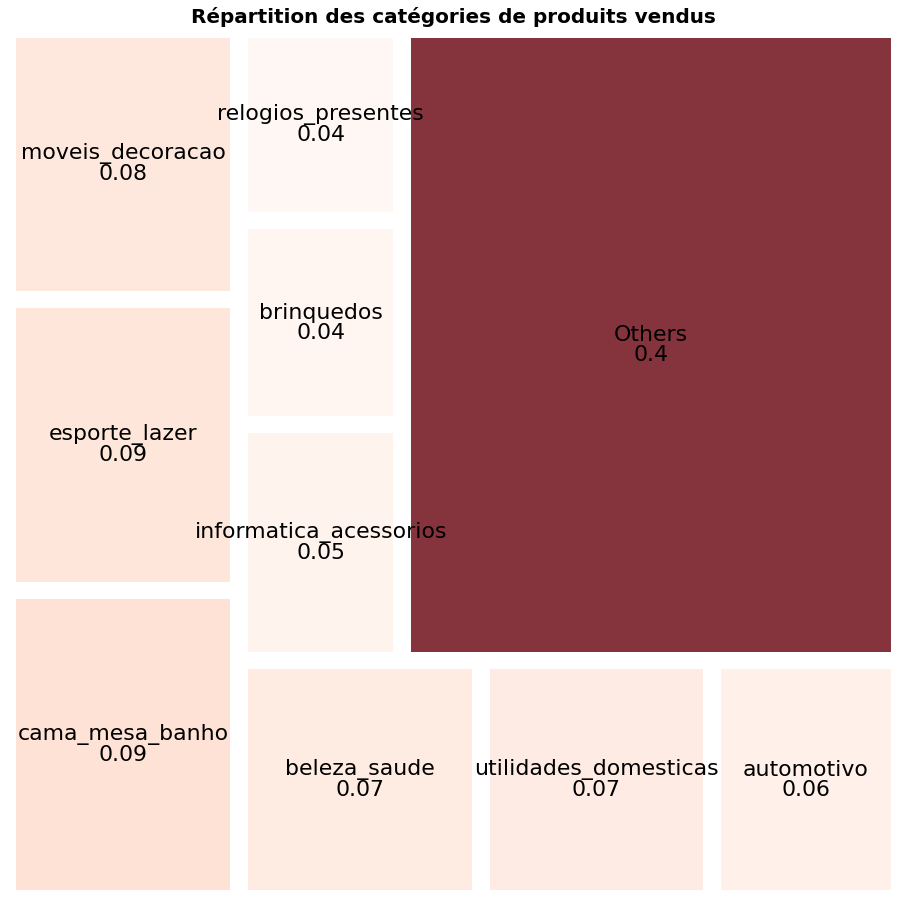

In [53]:
ex.squarify_value_counts(products.product_category_name, nb_square=10, title='Répartition des catégories de produits vendus')

# Analyse bivariée

- Quelle période ramène le + d'argent
- Commande des clients sur une période donnée (RFM)
- Quelle catégorie d'objets rapportent le +

## D'où provient le maximum de revenus

https://www.kaggle.com/andresionek/geospatial-analysis-of-brazilian-e-commerce

Je cherche ici à identifier les zones 

In [100]:
customers.customer_city.value_counts()

sao paulo         15540
rio de janeiro     6882
belo horizonte     2773
brasilia           2131
curitiba           1521
                  ...  
camacho               1
varzedo               1
ouvidor               1
alto sao joao         1
rio dos cedros        1
Name: customer_city, Length: 4119, dtype: int64

In [104]:
geolocation

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,01037,-23.545621,-46.639292,sao paulo,SP
1,01046,-23.546081,-46.644820,sao paulo,SP
2,01046,-23.546129,-46.642951,sao paulo,SP
3,01041,-23.544392,-46.639499,sao paulo,SP
4,01035,-23.541578,-46.641607,sao paulo,SP
...,...,...,...,...,...
1000158,99950,-28.068639,-52.010705,tapejara,RS
1000159,99900,-27.877125,-52.224882,getulio vargas,RS
1000160,99950,-28.071855,-52.014716,tapejara,RS
1000161,99980,-28.388932,-51.846871,david canabarro,RS


# Analyse multivariée

In [3]:
prefix = './csv_files/'

data = pd.read_csv(prefix + 'full_data.csv').astype({'order_purchase_timestamp':'datetime64','order_approved_at':'datetime64','order_delivered_carrier_date':'datetime64','order_delivered_customer_date':'datetime64','order_estimated_delivery_date':'datetime64'})

## Preprocessing

Je fusionne l'ensemble des datasets pour pouvoir sélectionner plus facilement les colonnes nécessaires.

<div>
<img src="https://i.imgur.com/HRhd2Y0.png" width="1000"/>
</div>

Le schéma ci-dessus me donne les liens entre chacun des datasets. Je vais suivre ces liens pour les fusionner. <br>

In [146]:
data =  pd.merge(products,
            pd.merge(items,
                    pd.merge(customers,
                            pd.merge(payments,
                                    pd.merge(orders,
                                             reviews, 
                                             how='inner', on='order_id'
                                            ),
                                    how='inner', on='order_id'
                                    ),
                             how='inner', on='customer_id'
                            ),
                     how='inner', on='order_id'
                    ),
        how='inner', on='product_id'
        )

### Restriction à la période d'étude

Comme présenté dans l'EDA, une période d'étude plus pertinente serait du **1er Janvier 2017 au 26 Aout 2018**, en dehors de cette période la quantité d'achat est trop instable pour être considérée comme valide.

In [147]:
from datetime import datetime

debut = datetime(2017,1,1,0,0,0)
fin = datetime(2018,8,26,23,59,59)

data = data[(data.order_approved_at >= debut) & (data.order_approved_at <= fin)]

In [148]:
print(f'Période d\'étude: {data.order_approved_at.min().ctime()} à {data.order_approved_at.max().ctime()}')

Période d'étude: Thu Jan  5 12:10:17 2017 à Sun Aug 26 23:45:08 2018


### Doublons

In [149]:
data.duplicated().sum()

0

### Valeurs non pertinentes

In [150]:
data = data[data.order_status == 'delivered']

In [151]:
data.drop(labels=['review_comment_title'], axis=1, inplace=True)

### FE

In [152]:
order_total_price = data.groupby('order_id').sum().price
order_total_price_df = pd.DataFrame(data=order_total_price).rename({'price':'order_total_price'}, axis=1)
data = pd.merge(data, order_total_price_df, how='inner', on='order_id')

In [153]:
order_total_freight = data.groupby('order_id').sum().freight_value
order_total_freight_df = pd.DataFrame(data=order_total_freight).rename({'freight_value':'order_total_freight'}, axis=1)
data = pd.merge(data, order_total_freight_df, how='inner', on='order_id')

### Traitement des NaNs

In [4]:
data.isnull().sum()

product_id                           0
product_category_name             1634
product_name_lenght               1634
product_description_lenght        1634
product_photos_qty                1634
product_weight_g                    20
product_length_cm                   20
product_height_cm                   20
product_width_cm                    20
order_id                             0
order_item_id                        0
seller_id                            0
shipping_limit_date                  0
price                                0
freight_value                        0
customer_id                          0
customer_unique_id                   0
customer_zip_code_prefix             0
customer_city                        0
customer_state                       0
payment_sequential                   0
payment_type                         0
payment_installments                 0
payment_value                        0
order_status                         0
order_purchase_timestamp 

Pas de NaNs sur nos variables.

### Sauvegarde du dataset

In [155]:
data.to_csv(prefix + 'full_data.csv', index=False)

## PCA et découverte de variables latentes

L'objectif ici est de déterminer les composantes principales de notre jeu de données pour pouvoir observer des combinaisons de variables pertinentes pour notre futur clustering.

In [5]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import pca_utilities as pca_util

### ACP sur données brutes

Ici, je n'ajoute pas de nouvelles variables.

In [28]:
data.dtypes.value_counts()

object            15
float64           12
datetime64[ns]     5
int64              5
dtype: int64

In [7]:
pca_df = data.select_dtypes(include=['float64', 'int64']).dropna()

In [8]:
pca_df.columns

Index(['product_name_lenght', 'product_description_lenght',
       'product_photos_qty', 'product_weight_g', 'product_length_cm',
       'product_height_cm', 'product_width_cm', 'order_item_id', 'price',
       'freight_value', 'customer_zip_code_prefix', 'payment_sequential',
       'payment_installments', 'payment_value', 'review_score',
       'order_total_price', 'order_total_freight'],
      dtype='object')

In [9]:
scaler = StandardScaler()
X_scaled = scaler.fit_transform(pca_df)

pca = PCA()
pca.fit(X_scaled)

PCA()

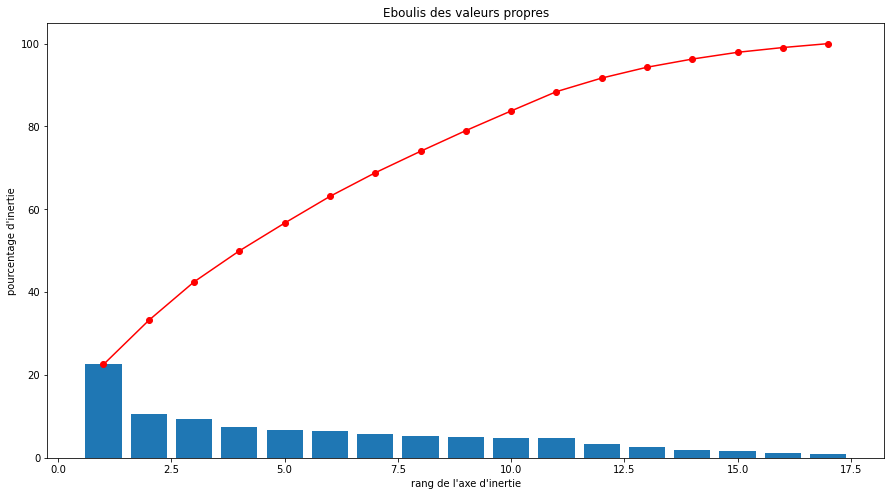

In [10]:
plt.figure(figsize=(15,8))
pca_util.display_scree_plot(pca)

<font color='red'><b>Observations</b></font> <br>

- Je n'ai qu'un axe qui se distingue des autres et c'est le premier.

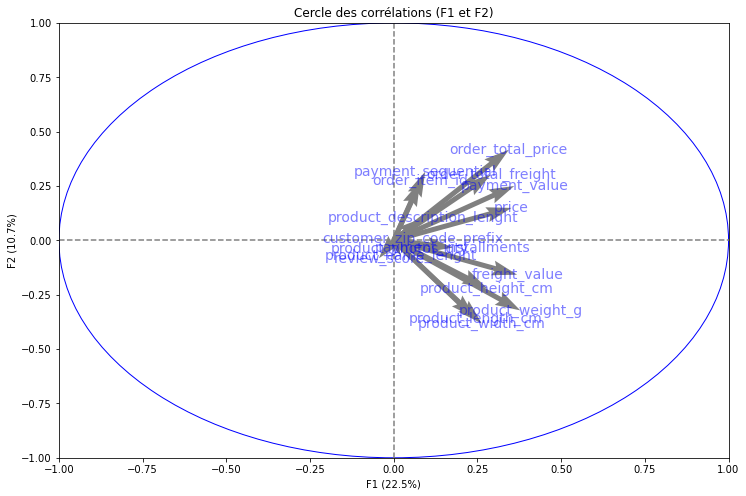

In [11]:
n_comp = len(pca_df.columns)


# Cercle des corrélations
pcs = pca.components_
pca_util.display_circles(pcs, n_comp, pca, [(0,1)], labels = np.array(pca_df.columns), figsize=(12,8))

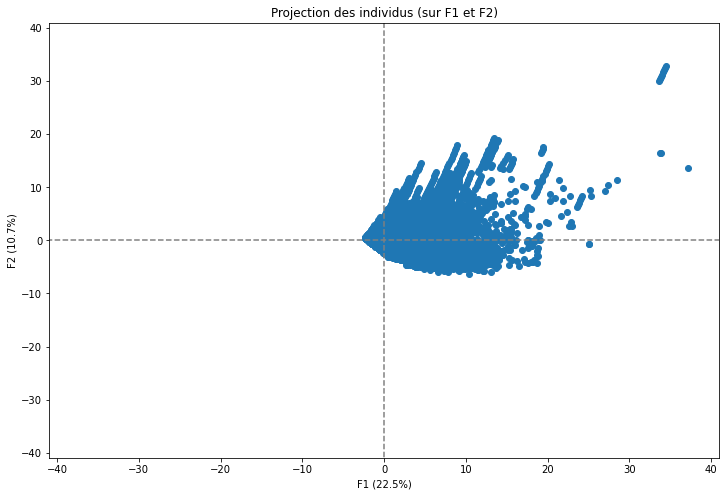

In [12]:
# Projection des individus
X_projected = pca.transform(X_scaled)
pca_util.display_factorial_planes(X_projected, n_comp, pca, [(0,1)], figsize=(12,8))

<font color='red'><b>Observations</b></font> <br>

- Cette analyse met en avant la présence d'outliers (en haut à droite) mais ne permet pas de séparer correctement les commandes passées

### ACP avec FE

Je fais ici une analyse des clients et non plus des commandes. <br> 

Je cherche en outre à ajouter des KPIs qui me permettront de séparer au mieux mes catégories de client. <br>
Pour cela je détermine 3 catégories de KPIs: <br>

- Geographique
    - Etat du client
- Fidélité (Une fois l'achat passé)
    - Nb de commentaires laissées
    - Moyenne des notes laissées
    - Nombre total de commandes passées
- Achat
    - Nombre moyen de produits par commandes
    - Prix moyen par commande
    - Mode de paiement
    - Date du dernier achat

#### Création de KPIs

**Etat du client**

In [13]:
tmp = data.copy()

tmp.drop_duplicates(subset='customer_unique_id', inplace=True)
tmp.set_index('customer_unique_id',inplace=True)

customer_state = tmp.customer_state

**Nombre de commentaires laissés**

In [14]:
nb_comments = data.groupby('customer_unique_id').count().review_comment_message

**Moyenne des notes laissés**

In [15]:
mean_review_score = data.groupby('customer_unique_id').mean().review_score

**Nombre total de commandes passées**

In [16]:
tmp = data.copy()

tmp.drop_duplicates(subset='order_id', inplace=True) # J'ai plusieurs fois le même order_id si le client a commandé plusieurs produits
tmp.set_index('order_id',inplace=True)

total_commands = tmp.customer_unique_id.value_counts()

**Nombre moyens de produits par commandes**

In [17]:
mean_product_by_command = (data.groupby('customer_unique_id').count().order_id/total_commands)

**Prix moyen par commande**

In [18]:
tmp = data.copy()

tmp.drop_duplicates(subset='order_id', inplace=True) # J'ai plusieurs fois le même order_id si le client a commandé plusieurs produits
tmp.set_index('order_id',inplace=True)

customer_mean_total_expenses = tmp.groupby('customer_unique_id').mean()['order_total_price'] + tmp.groupby('customer_unique_id').mean()['order_total_freight']

**Nombre moyen de versement**

In [19]:
tmp = data.copy()

tmp.drop_duplicates(subset='order_id', inplace=True) # J'ai plusieurs fois le même order_id si le client a commandé plusieurs produits
tmp.set_index('order_id', inplace=True)

mean_installments = tmp.groupby('customer_unique_id').mean()['payment_installments']

**Mode de paiement préféré**

In [20]:
tmp = data.copy()

tmp.drop_duplicates(subset='order_id', inplace=True) # J'ai plusieurs fois le même order_id si le client a commandé plusieurs produits
tmp.set_index('order_id', inplace=True)

tmp2 = pd.merge(tmp['customer_unique_id'], pd.get_dummies(tmp.payment_type), how='inner', on='order_id')
fav_paym_df = tmp2.groupby('customer_unique_id').sum()

fav_payment = fav_paym_df.idxmax(axis=1)

**Date du dernier achat**

In [26]:
debut = datetime(2017,1,1,0,0,0)
fin = datetime(2018,8,26,23,59,59)

tmp = data.copy()

tmp.drop_duplicates(subset='order_id', inplace=True) # J'ai plusieurs fois le même order_id si le client a commandé plusieurs produits
tmp.set_index('order_id', inplace=True)
tmp = tmp[['customer_unique_id', 'order_approved_at']]

customer_recence = fin - tmp.groupby('customer_unique_id').max()['order_approved_at']
customer_recence = customer_recence.apply(func=lambda x: x.days) # Je ne conserve que les jours

#### Nouveau dataset

In [46]:
kpi_df = pd.DataFrame(data={'customer_state': customer_state, 'nb_comments': nb_comments, 'mean_review_score':mean_review_score, 'total_commands': total_commands, 
                   'mean_product_by_command':mean_product_by_command, 'customer_mean_total_expenses':customer_mean_total_expenses, 'mean_installments':mean_installments,
                            'fav_payment':fav_payment, 'recence': customer_recence}, 
             index=customer_state.index)

In [47]:
kpi_df.to_csv(prefix + 'kpi.csv')

In [ ]:
kpi_df

#### Preprocessing